# Feature Engineering notebook
Loads the lightweight clean data, and finds the most useful features for per-step awake classification 

## Imports

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import seaborn as sns
import plotly.express as px
import gc

## Prepare data

In [2]:
data = pd.read_parquet('../../../data/raw/Zzzs_train.parquet')
data.rename(columns={'awake':'target'}, inplace=True)
data.head()

,series_id,step,timestamp,anglez,enmo,target
0,08db4255286f,0,2018-11-05T10:00:00-0400,-30.845301,0.0447,1
1,08db4255286f,1,2018-11-05T10:00:05-0400,-34.181801,0.0443,1
2,08db4255286f,2,2018-11-05T10:00:10-0400,-33.877102,0.0483,1
3,08db4255286f,3,2018-11-05T10:00:15-0400,-34.282101,0.0680,1
4,08db4255286f,4,2018-11-05T10:00:20-0400,-34.385799,0.0768,1


Determine train test split based on series_id, and add this as a column

In [3]:
sids = data.series_id.unique()
test_size = 0.2
np.random.seed(42)
np.random.shuffle(sids)
data['train'] = data.series_id.isin(sids[:-int(len(sids)*test_size)])

## Helper functions
Define a function that will be used to determine usefulness of a feature, by training a simple classifier on the feature, and returning the auroc score
Also add functions to show the results

In [4]:
def compute_feature_importance(df, feature, res_dict=None, plot=False, subsample=100, plot_limit=17280, plot_subsample=1):
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_auc_score
    cols = [feature, 'target','train']
    selection = df[cols][::subsample]
    train = selection[selection.train]
    test = selection[~selection.train]
    
    clf = LogisticRegression()
    clf.fit(train[[feature]], train.target)
    preds = clf.predict_proba(test[[feature]])[:,1]
    score = roc_auc_score(test.target, preds)
    
    if res_dict is not None:
        res_dict[feature] = score
        
    if plot:
        # plot with plotly
        print(f"AUROC: {score:.4f}")
        preds_df = pd.DataFrame({'target':test.target, 'pred':preds})
        preds_df = preds_df[:plot_limit:plot_subsample]
        fig = px.line(preds_df, x=range(len(preds_df)), y=['pred', 'target'])
        fig.show()    
    return score

In [5]:
res = dict()

In [6]:
def show_res(res, with_plotly=False):
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    if with_plotly:
        # plot with plotly
        fig = px.bar(res_df, x=res_df.index, y='auroc', title='Feature explanation power (logistic regression)')
        fig.show()
        return
    else:
        # plot with seaborn
        ax = sns.barplot(x=res_df.index, y=res_df.auroc, palette="deep")
        ax.bar_label(ax.containers[0], fmt='%.4f', label_type='edge')
        plt.xticks(rotation=45)
        plt.show()

# Let's start

Compute the importance of the standard features

  0%|          | 0/2 [00:00<?, ?it/s]

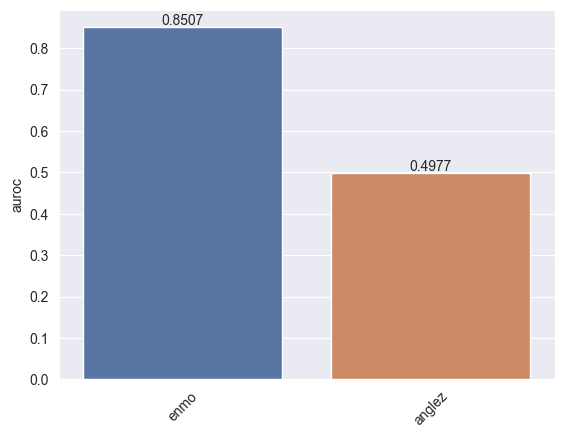

In [7]:
feats = ['anglez', 'enmo']
for feat in tqdm(feats):
    compute_feature_importance(data, feat, res)
show_res(res)

Add some features to make anglez more usable

Computing features


Computing feature importance:   0%|          | 0/3 [00:00<?, ?it/s]

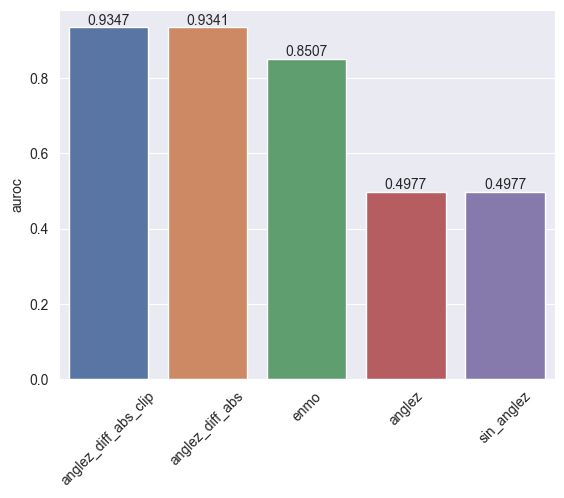

In [8]:
print('Computing features')
data['anglez_diff_abs'] = np.abs(data.anglez.diff()).fillna(0).astype(np.float32)
data['anglez_diff_abs_clip'] = np.clip(data.anglez_diff_abs, 0, 10).astype(np.float32)
data['sin_anglez'] = np.sin(data.anglez/180*np.pi).astype(np.float32)
feats = ['anglez_diff_abs', 'sin_anglez', 'anglez_diff_abs_clip']
for feat in tqdm(feats, desc='Computing feature importance'):
    if feat in res:
        continue
    compute_feature_importance(data, feat, res)
show_res(res)

Lets add the hour features, but instead of the value, use the proportion for which children are awake at that hour in the train set

Extracting hour from timestamp
Mapping hour to proportion of awake


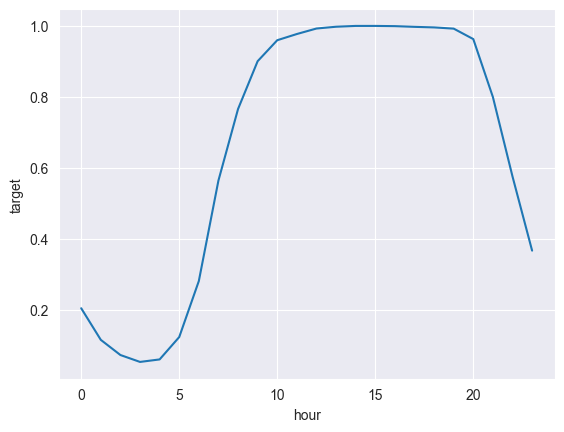

Smoothing the feature with a rolling mean
Computing feature importance


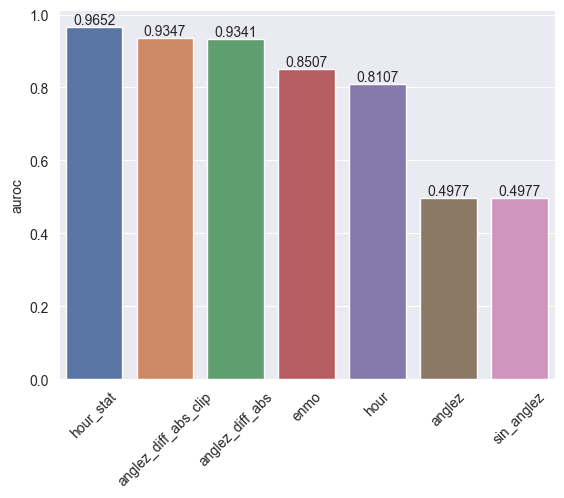

In [9]:
# since converting to timestamp is super slow, do it with substring, 
# using that the date format is like 2018-11-05T10:00:00-0400
print("Extracting hour from timestamp")
data['hour'] = data.timestamp.str[11:13].astype(int)

print("Mapping hour to proportion of awake")
hour_stats = data[data.train].groupby('hour').target.mean()
sns.lineplot(data=hour_stats)
plt.show()
data['hour_stat'] = data.hour.map(hour_stats)

print("Smoothing the feature with a rolling mean")
sec_per_step= 5
data['hour_stat'] = data.hour_stat.rolling(60*60//sec_per_step, center=True).mean().ffill().bfill().astype(np.float32)

print("Computing feature importance")
compute_feature_importance(data, 'hour', res)
compute_feature_importance(data, 'hour_stat', res)

show_res(res)

Also add the minute feature directly

Extracting minute from timestamp


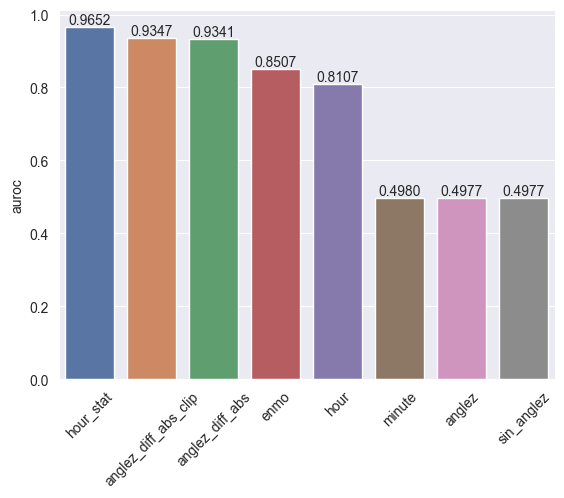

In [10]:
print("Extracting minute from timestamp")
data['minute'] = data.timestamp.str[14:16].astype(int)
compute_feature_importance(data, 'minute', res)
show_res(res)

These will form our basic features.
We distinguish which ones to compute a rolling window for.

In [11]:
basic_feats = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez', 'hour', 'hour_stat']
basic_feats_for_rolling = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez']

# Now let's add some rolling statistics

In [12]:
print("Computing rolling statistics")
stats = ['mean', 'std', 'min', 'max', 'median', 'skew','kurt']
window_sizes = [6, 12, 36, 50, 90, 180, 360, 500, 1000]
pbar = tqdm(total=len(stats)*len(basic_feats_for_rolling)*len(window_sizes))
new_feats = dict()
for stat in stats:
    for feat in basic_feats_for_rolling:
        for window_size in window_sizes:
            name = f'{feat}_{stat}_{window_size}'
            pbar.set_description(f'Computing {name}')
            if name not in data.columns:
                new_feats[name] = data[feat].rolling(window_size, center=True).agg(stat).ffill().bfill().astype(np.float32)
            pbar.update()
pbar.close()

# concatenate the new features with the original data
print("Concatenating new features")
new_feats_df = pd.DataFrame(new_feats)
data = pd.concat([data, new_feats_df], axis=1)
print("Cleaning up")
del new_feats_df
gc.collect()

Computing rolling statistics


  0%|          | 0/252 [00:00<?, ?it/s]

Concatenating new features
Cleaning up


7399

Compute a savgol filter, which is a moothing function

In [13]:
from scipy.signal import savgol_filter
window_sizes = [6, 12, 36, 50, 90, 180, 360, 500, 1000]
pbar = tqdm(total=len(window_sizes)*len(basic_feats_for_rolling))
savgol_feats = []
for window_size in window_sizes:
    for feat in basic_feats_for_rolling:
        name = f'{feat}_savgol_{window_size}'
        pbar.set_description(f'Computing {name}')
        if name not in data.columns:
            data[name] = savgol_filter(data[feat], window_size, 3)
        pbar.update()        
        savgol_feats.append(name)

  0%|          | 0/36 [00:00<?, ?it/s]

In [14]:
if 'data' in locals():
    data.to_parquet('../../../data/processed/Zzzs_train_features.parquet')
else:
    data = pd.read_parquet('../../../data/processed/Zzzs_train_features.parquet')

In [15]:
rolling_feats = [f for f in data.columns if any([stat in f for stat in stats])]
pbar = tqdm(rolling_feats + savgol_feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res:
        continue
    compute_feature_importance(data, feat, res) 
pbar.close()

  0%|          | 0/289 [00:00<?, ?it/s]

C:\Users\EmielW\Epoch\Competitions\cmi\q1-detect-sleep-states\venv\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [16]:
show_res(res, with_plotly=True)

Compute the correlation between the features (with a subset of the data for performance reasons)
We can use this to select features that are not too correlated.

In [17]:
def select_useful_uncorrelated(data, res, subsample=1000):
    data_corr = data[::subsample].corr(numeric_only=True)
    
    # select features by sorting the res descending, and removing features that are too correlated to the ones that came before
    selection = []
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    for feat in res_df.index:
        if len(selection) == 0:
            selection.append(feat)
            continue
        if data_corr.loc[feat, selection].abs().max() < 0.9:
            selection.append(feat)
    
    print(f"Selected {len(selection)} features out of {len(res)}")
    print(selection)
    return data_corr, selection
    

In [18]:
data_corr, selection_long = select_useful_uncorrelated(data, res, subsample=1000)

Selected 146 features out of 296
['anglez_diff_abs_clip_skew_1000', 'anglez_diff_abs_clip_mean_1000', 'anglez_diff_abs_clip_kurt_1000', 'anglez_diff_abs_clip_skew_500', 'anglez_diff_abs_kurt_1000', 'anglez_diff_abs_clip_kurt_500', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_median_360', 'enmo_mean_1000', 'enmo_std_500', 'anglez_diff_abs_median_90', 'anglez_diff_abs_kurt_500', 'anglez_diff_abs_clip_std_360', 'anglez_diff_abs_clip_mean_36', 'enmo_mean_360', 'enmo_max_1000', 'hour_stat', 'anglez_diff_abs_clip_median_12', 'enmo_std_180', 'anglez_diff_abs_clip_skew_180', 'enmo_max_360', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_1000', 'anglez_diff_abs_median_6', 'anglez_diff_abs_clip_min_12', 'anglez_diff_abs_min_6', 'enmo_std_50', 'anglez_diff_abs_mean_12', 'anglez_diff_abs_clip_min_36', 'anglez_diff_abs_kurt_360', 'enmo_mean_90', 'enmo_max_90', 'anglez_diff_abs_std_360', 'enmo_std_12', 'anglez_diff_abs_min_50', 'enmo_std_6', 'anglez_diff_abs_clip', 'sin_anglez_std_6',

## Plotting
Plot the result of a predictor trained on all features

In [19]:
def train_model(data, feats, plot_preds=False, target='target', plot_days=5, plot_subsample=1):
    from catboost import CatBoostClassifier
    from sklearn.metrics import roc_auc_score
    train = data[data.train]
    test = data[~data.train]
    clf = CatBoostClassifier(eval_metric='AUC')
    clf.fit(train[feats], train[target], eval_set=(test[feats], test[target]), early_stopping_rounds=5)
    preds = clf.predict_proba(test[feats])[:,1]
    auroc = roc_auc_score(test[target], preds)
    print(f"AUROC: {auroc:.4f}")
    
    if plot_preds:
        # plot with plotly detailed
        df = pd.DataFrame({'preds': preds, 'target': test[target]})
        df_display = df[:plot_days*17280:plot_subsample]
        fig = px.line(df_display, x=range(len(df_display)), y=['preds', 'target'])
        fig.show()
    
    return clf, auroc

In [20]:
clf_long, _ = train_model(data, basic_feats + rolling_feats + savgol_feats, plot_preds=True)

Learning rate set to 0.309538
0:	test: 0.9938754	best: 0.9938754 (0)	total: 1.53s	remaining: 25m 30s
1:	test: 0.9951480	best: 0.9951480 (1)	total: 2.8s	remaining: 23m 15s
2:	test: 0.9956757	best: 0.9956757 (2)	total: 3.98s	remaining: 22m 4s
3:	test: 0.9960644	best: 0.9960644 (3)	total: 5.3s	remaining: 22m
4:	test: 0.9961306	best: 0.9961306 (4)	total: 6.37s	remaining: 21m 7s
5:	test: 0.9960503	best: 0.9961306 (4)	total: 7.64s	remaining: 21m 6s
6:	test: 0.9961430	best: 0.9961430 (6)	total: 9.22s	remaining: 21m 48s
7:	test: 0.9963189	best: 0.9963189 (7)	total: 11.1s	remaining: 22m 58s
8:	test: 0.9963991	best: 0.9963991 (8)	total: 12.3s	remaining: 22m 30s
9:	test: 0.9963653	best: 0.9963991 (8)	total: 13.6s	remaining: 22m 22s
10:	test: 0.9963987	best: 0.9963991 (8)	total: 14.8s	remaining: 22m 6s
11:	test: 0.9964171	best: 0.9964171 (11)	total: 16s	remaining: 21m 54s
12:	test: 0.9964648	best: 0.9964648 (12)	total: 17.3s	remaining: 21m 55s
13:	test: 0.9964698	best: 0.9964698 (13)	total: 18.3s	

In [21]:
def get_importances(clf, feats, plot=True):
    importances = clf.get_feature_importance()
    importances_df = pd.DataFrame({'feature':feats, 'importance':importances})
    importances_df.importance /= importances_df.importance.sum()
    importances_df.sort_values('importance', ascending=False, inplace=True)
    if plot:
        fig = px.bar(importances_df, x='feature', y='importance')
        fig.show()
    return importances_df

In [22]:
importances_long = get_importances(clf_long, basic_feats + rolling_feats + savgol_feats)

In [23]:
# Repeat with selection
clf_long_selection, _ = train_model(data, selection_long, plot_preds=True)
importances_long_selection = get_importances(clf_long_selection, selection_long)

Learning rate set to 0.309538
0:	test: 0.9935976	best: 0.9935976 (0)	total: 823ms	remaining: 13m 42s
1:	test: 0.9954722	best: 0.9954722 (1)	total: 1.58s	remaining: 13m 7s
2:	test: 0.9959631	best: 0.9959631 (2)	total: 2.49s	remaining: 13m 46s
3:	test: 0.9960062	best: 0.9960062 (3)	total: 3.36s	remaining: 13m 56s
4:	test: 0.9960610	best: 0.9960610 (4)	total: 4.39s	remaining: 14m 34s
5:	test: 0.9961978	best: 0.9961978 (5)	total: 5.53s	remaining: 15m 16s
6:	test: 0.9962884	best: 0.9962884 (6)	total: 6.38s	remaining: 15m 4s
7:	test: 0.9963258	best: 0.9963258 (7)	total: 7.45s	remaining: 15m 23s
8:	test: 0.9962967	best: 0.9963258 (7)	total: 8.24s	remaining: 15m 7s
9:	test: 0.9963303	best: 0.9963303 (9)	total: 9.15s	remaining: 15m 6s
10:	test: 0.9963346	best: 0.9963346 (10)	total: 9.78s	remaining: 14m 39s
11:	test: 0.9962721	best: 0.9963346 (10)	total: 10.4s	remaining: 14m 17s
12:	test: 0.9963314	best: 0.9963346 (10)	total: 11.1s	remaining: 14m 6s
13:	test: 0.9963700	best: 0.9963700 (13)	total

# Precise dataset
So far we have measured AUROC across the entire day. Preferring features that are good for a high-level overview.
Now we will try to predict awake for only the short windows around transitions of the target.

In [24]:
# first compute the transitions
window_size = 180
data['transition'] = (data.target != data.target.shift(1)).astype(int)
data['window'] = data.transition.rolling(window_size, center=True).sum().ffill().bfill()

In [25]:
# plot the first few windows
data_start = data[:50000:18][['step', 'target', 'window']]
px.scatter(data_start, x='step', y='target', color='window')

Ran into some memory issues here when filtering the dataset, so lets print the memory usage for debugging purposes

In [26]:
import gc
mem = data.memory_usage().sum()/(1024**3)
print(f"Dataframe size before selection: {mem:.2f} GB")
gc.collect()

Dataframe size before selection: 15.02 GB


2021

In [27]:
# make a new dataset with only the windows
data_windows = data[data.window>0].copy()
mem = data_windows.memory_usage().sum()/(1024**3)
print(f"Datafram after selection: {mem:.2f} GB")
gc.collect()

Datafram after selection: 0.31 GB


0

# Precise datset feature importance

In [28]:
res_windows = dict()
feats = basic_feats + rolling_feats + savgol_feats
pbar = tqdm(feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res_windows:
        continue
    compute_feature_importance(data_windows, feat, res_windows)

  0%|          | 0/295 [00:00<?, ?it/s]

In [29]:
show_res(res_windows, with_plotly=True)

In [30]:
# select features by sorting the res descending, and removing features that are too correlated to the ones that came before
data_corr_short, selection_short = select_useful_uncorrelated(data_windows, res_windows, subsample=10)

Selected 162 features out of 295
['anglez_diff_abs_clip_savgol_180', 'anglez_diff_abs_savgol_90', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_90', 'anglez_diff_abs_std_50', 'anglez_diff_abs_clip_std_50', 'enmo_std_50', 'anglez_diff_abs_clip_skew_180', 'anglez_diff_abs_mean_180', 'enmo_std_90', 'anglez_diff_abs_clip_std_180', 'sin_anglez_std_50', 'anglez_diff_abs_clip_skew_90', 'anglez_diff_abs_clip_median_90', 'anglez_diff_abs_clip_kurt_90', 'anglez_diff_abs_median_180', 'anglez_diff_abs_median_360', 'sin_anglez_std_90', 'enmo_savgol_180', 'anglez_diff_abs_median_36', 'anglez_diff_abs_clip_mean_12', 'anglez_diff_abs_std_180', 'anglez_diff_abs_clip_max_36', 'anglez_diff_abs_clip_max_50', 'anglez_diff_abs_max_12', 'anglez_diff_abs_clip_mean_360', 'anglez_diff_abs_clip_max_12', 'anglez_diff_abs_kurt_180', 'enmo_std_12', 'enmo_mean_180', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_kurt_360', 'anglez_diff_abs_mean_6', 'anglez_diff_abs_clip_max_6', 'anglez_diff_abs_median_

# Lets visualize the predictions of a model trained on the precise dataset

In [31]:
clf_short, auroc = train_model(data_windows, feats, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.8975998	best: 0.8975998 (0)	total: 42.2ms	remaining: 42.2s
1:	test: 0.9067670	best: 0.9067670 (1)	total: 84.6ms	remaining: 42.2s
2:	test: 0.9094614	best: 0.9094614 (2)	total: 124ms	remaining: 41.3s
3:	test: 0.9116872	best: 0.9116872 (3)	total: 168ms	remaining: 41.8s
4:	test: 0.9129210	best: 0.9129210 (4)	total: 206ms	remaining: 40.9s
5:	test: 0.9136911	best: 0.9136911 (5)	total: 247ms	remaining: 40.9s
6:	test: 0.9137014	best: 0.9137014 (6)	total: 286ms	remaining: 40.6s
7:	test: 0.9148659	best: 0.9148659 (7)	total: 323ms	remaining: 40.1s
8:	test: 0.9164167	best: 0.9164167 (8)	total: 365ms	remaining: 40.1s
9:	test: 0.9165448	best: 0.9165448 (9)	total: 405ms	remaining: 40.1s
10:	test: 0.9178793	best: 0.9178793 (10)	total: 443ms	remaining: 39.8s
11:	test: 0.9183921	best: 0.9183921 (11)	total: 484ms	remaining: 39.9s
12:	test: 0.9181477	best: 0.9183921 (11)	total: 520ms	remaining: 39.5s
13:	test: 0.9187995	best: 0.9187995 (13)	total: 557ms	remaining: 

In [32]:
importances_short = get_importances(clf_short, feats)

In [33]:
# Repeat with selection
clf_short_selection, auroc = train_model(data_windows, selection_short, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.9042862	best: 0.9042862 (0)	total: 35.1ms	remaining: 35.1s
1:	test: 0.9085787	best: 0.9085787 (1)	total: 64.1ms	remaining: 32s
2:	test: 0.9114498	best: 0.9114498 (2)	total: 93.2ms	remaining: 31s
3:	test: 0.9118556	best: 0.9118556 (3)	total: 119ms	remaining: 29.7s
4:	test: 0.9127250	best: 0.9127250 (4)	total: 147ms	remaining: 29.3s
5:	test: 0.9129451	best: 0.9129451 (5)	total: 176ms	remaining: 29.2s
6:	test: 0.9136715	best: 0.9136715 (6)	total: 207ms	remaining: 29.3s
7:	test: 0.9142409	best: 0.9142409 (7)	total: 240ms	remaining: 29.8s
8:	test: 0.9140211	best: 0.9142409 (7)	total: 267ms	remaining: 29.4s
9:	test: 0.9156715	best: 0.9156715 (9)	total: 298ms	remaining: 29.5s
10:	test: 0.9160439	best: 0.9160439 (10)	total: 328ms	remaining: 29.5s
11:	test: 0.9159375	best: 0.9160439 (10)	total: 358ms	remaining: 29.5s
12:	test: 0.9164253	best: 0.9164253 (12)	total: 391ms	remaining: 29.7s
13:	test: 0.9168743	best: 0.9168743 (13)	total: 426ms	remaining: 30s

In [34]:
importances_short_selection = get_importances(clf_short_selection, selection_short)

# Event features
These features work well for state segmentation. Now let's see which features work well for events. And add a few features that make more sense for events.
Starting by getting the moments (i.e. slope etc.) of the most important state segmentation features, for both long-term and precise.
Also add onset_stat and wakeup_stat.

In [35]:
# take the most important features from both long and short-term feature importance
threshold = 0.01
imp_long = importances_long_selection
imp_short = importances_short_selection
feats_long = imp_long[imp_long.importance>threshold].feature.tolist()
feats_short = imp_short[imp_short.importance>threshold].feature.tolist()
feats_good = list(set(feats_long + feats_short))

# combine them in a dataframe with importances
feats_df = pd.DataFrame({'feature':feats_good})
feats_df['importance_long'] = feats_df.feature.map(imp_short.set_index('feature').importance)
feats_df['importance_short'] = feats_df.feature.map(imp_long.set_index('feature').importance)

print(f"Selected {len(feats_good)} features")
print(feats_good)
feats_df

Selected 39 features
['anglez_diff_abs_max_360', 'anglez_diff_abs_clip_savgol_180', 'enmo_median_36', 'sin_anglez_median_500', 'enmo_mean_180', 'anglez_diff_abs_max_1000', 'enmo_skew_1000', 'hour_stat', 'anglez_diff_abs_std_1000', 'anglez_diff_abs_clip_median_360', 'sin_anglez_min_1000', 'enmo_std_50', 'sin_anglez_skew_180', 'sin_anglez_kurt_180', 'anglez_diff_abs_median_180', 'sin_anglez_kurt_1000', 'enmo_max_500', 'enmo_std_90', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_clip_max_36', 'anglez_diff_abs_clip_median_1000', 'anglez_diff_abs_clip_min_500', 'enmo_std_12', 'anglez_diff_abs_median_90', 'anglez_diff_abs_clip_median_90', 'sin_anglez_kurt_90', 'anglez_diff_abs_clip_skew_180', 'anglez_diff_abs_clip_mean_1000', 'anglez_diff_abs_median_36', 'enmo_max_1000', 'enmo_savgol_180', 'enmo_median_1000', 'hour', 'sin_anglez_skew_1000', 'sin_anglez_max_1000', 'anglez_diff_abs_std_50', 'enmo_mean_1000', 'anglez_diff_abs_clip_skew_1000', 'anglez_diff_abs_kurt_1000']


,feature,importance_long,importance_short
0,anglez_diff_abs_max_360,0.010049,0.000000
1,anglez_diff_abs_clip_savgol_180,0.084617,NaN
2,enmo_median_36,0.010451,NaN
3,sin_anglez_median_500,0.020638,0.002265
4,enmo_mean_180,0.012938,NaN
5,anglez_diff_abs_max_1000,0.003801,0.010481
6,enmo_skew_1000,0.019052,NaN
7,hour_stat,0.020914,0.287144
8,anglez_diff_abs_std_1000,0.014627,0.007514
9,anglez_diff_abs_clip_median_360,NaN,0.218857


Compute moments

In [36]:
# compute slope (diff)
print("Computing slope")
feats_moments = list()
for feat in tqdm(feats_good):
    name = f'{feat}_diff'
    if name not in data.columns:
        data[name] = data[feat].diff().fillna(0).astype(np.float32)
    if name not in feats_moments:
        feats_moments.append(name)

Computing slope


  0%|          | 0/39 [00:00<?, ?it/s]

In [37]:
# Create event labels, which are the diff of awake
print("Computing event labels")
data['event_wakeup'] = data.target.diff().fillna(0).astype(int).clip(0,1)

Computing event labels


Compute the event stat feature

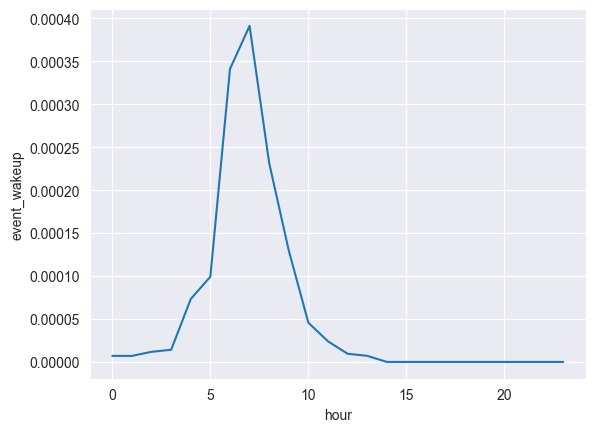

In [38]:
hour_wakeup_stats = data[data.train].groupby('hour')['event_wakeup'].mean()
data['hour_wakeup_stat'] = data.hour.map(hour_wakeup_stats)
sns.lineplot(data=hour_wakeup_stats)
plt.show()

Train a model

In [39]:
# train a model on events 
print("Training event model")
feats = list(set(feats_good + feats_moments + ['hour_wakeup_stat']))
gc.collect()
clf_event, auroc = train_model(data, feats, target='event_wakeup', plot_preds=True, plot_days=5, plot_subsample=1)

Training event model
Learning rate set to 0.309538
0:	test: 0.7092362	best: 0.7092362 (0)	total: 535ms	remaining: 8m 54s
1:	test: 0.7141355	best: 0.7141355 (1)	total: 1.14s	remaining: 9m 28s
2:	test: 0.7104500	best: 0.7141355 (1)	total: 1.69s	remaining: 9m 21s
3:	test: 0.7612194	best: 0.7612194 (3)	total: 2.21s	remaining: 9m 9s
4:	test: 0.9823116	best: 0.9823116 (4)	total: 2.79s	remaining: 9m 14s
5:	test: 0.9886548	best: 0.9886548 (5)	total: 3.44s	remaining: 9m 29s
6:	test: 0.9920507	best: 0.9920507 (6)	total: 4.04s	remaining: 9m 33s
7:	test: 0.9931472	best: 0.9931472 (7)	total: 4.65s	remaining: 9m 36s
8:	test: 0.9932647	best: 0.9932647 (8)	total: 5.19s	remaining: 9m 31s
9:	test: 0.9933517	best: 0.9933517 (9)	total: 5.71s	remaining: 9m 25s
10:	test: 0.9937018	best: 0.9937018 (10)	total: 6.5s	remaining: 9m 44s
11:	test: 0.9939181	best: 0.9939181 (11)	total: 7.07s	remaining: 9m 42s
12:	test: 0.9940243	best: 0.9940243 (12)	total: 7.71s	remaining: 9m 45s
13:	test: 0.9940723	best: 0.9940723

In [40]:
# show importances
importances_event = get_importances(clf_event, feats)

# Get a performance estimate

Computing error


  0%|          | 0/172 [00:00<?, ?it/s]

Plotting error


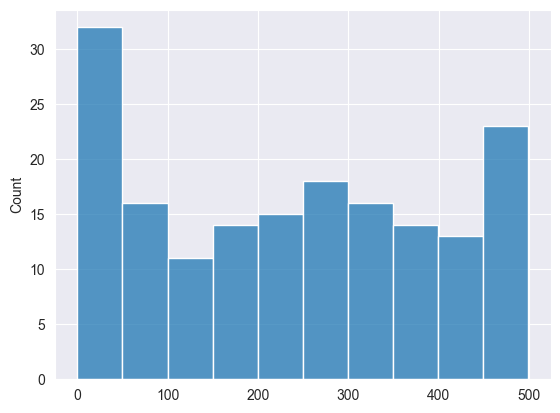

In [41]:
test = data[~data.train]
preds = clf_event.predict_proba(test[feats])[:,1]
target = test.event_wakeup

# iterate over all wakeups, get the argmax of the preds within 500 steps, and compute the distance
# this is a bit slow, but it's only for evaluation
print("Computing error")
errors = []
for onset in tqdm(test[test.event_wakeup==1].step):
    preds_window = preds[onset-500:onset+500]
    pred = preds_window.argmax()
    error = np.abs(pred-500)
    errors.append(error)
    
    sns.lineplot(x=np.arange(-500,500,1), y=preds_window)
    plt.axvline(x=0, color='red')
    plt.savefig(f'./plots/pred_{onset}')
    plt.close()
    
# show a histogram of the errors
print("Plotting error")
sns.histplot(errors, bins=10)
plt.show()

# Final summary
Show the feature importances for all models

In [42]:
print("Long-term model")
feats = basic_feats + rolling_feats + savgol_feats
get_importances(clf_long, feats)

print("Precise model")
feats = basic_feats + rolling_feats + savgol_feats
get_importances(clf_short, feats)

print("Precise model selection")
feats = selection_short
get_importances(clf_short_selection, feats)

print("Event model")
feats = list(set(feats_good + feats_moments + ['hour_wakeup_stat']))
get_importances(clf_event, feats)
pass

Long-term model


Precise model


Precise model selection


Event model
